# Segunda Entrega de Proyecto: Procesamiento de Datos
## Desarrollado por: Juan Manuel Aguiar, Andres Felipe Duarte

In [0]:
# Importar librerias
from pyspark.sql import SparkSession
from pyspark.sql.functions import col, count, when, avg, sum, to_date, expr, regexp_replace
from pyspark.ml.feature import StringIndexer, VectorAssembler
from pyspark.ml.stat import Correlation
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, silhouette_score
from sklearn.cluster import KMeans

### Cargado de Datos

In [0]:
arrest_data = spark.table("arrests")
display(arrest_data)
print(arrest_data)

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261249590,01/02/2023,339,"LARCENY,PETIT FROM OPEN AREAS,",341,PETIT LARCENY,PL 1552500,M,M,6,0,25-44,M,BLACK,982745,206647,40.733876,-74.005428,POINT (-74.005428 40.733876)
261271301,01/03/2023,105,STRANGULATION 1ST,106,FELONY ASSAULT,PL 1211200,F,S,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
262235280,01/20/2023,109,"ASSAULT 2,1,UNCLASSIFIED",106,FELONY ASSAULT,PL 1200501,F,K,62,0,45-64,M,WHITE,983289,158770,40.602464,-74.00346,POINT (-74.00346 40.602464)
264404265,03/01/2023,101,ASSAULT 3,344,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,S,120,0,<18,F,BLACK,958743,173302,40.642316,-74.091908,POINT (-74.091908 40.642316)
264443630,03/02/2023,808,TAX LAW,125,OTHER STATE LAWS (NON PENAL LA,TAX181400A,F,K,83,0,25-44,F,WHITE,1006097,195371,40.702901,-73.921203,POINT (-73.921203 40.702901)
264943177,03/10/2023,101,ASSAULT 3,344,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,M,6,0,45-64,M,WHITE,983944,208569,40.739153,-74.001104,POINT (-74.001104 40.739153)
265798132,03/28/2023,157,RAPE 1,104,RAPE,PL 1303501,F,S,120,0,25-44,M,BLACK,962873,174172,40.6447209438691,-74.0770327198983,POINT (-74.0770327198983 40.6447209438691)
266141086,04/04/2023,null,(null),null,(null),PL 215401B,F,S,120,0,25-44,M,BLACK,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
266358046,04/07/2023,157,RAPE 1,104,RAPE,PL 1303501,F,S,120,0,45-64,M,BLACK,962873,174172,40.6447209438691,-74.0770327198983,POINT (-74.0770327198983 40.6447209438691)
269233687,06/02/2023,157,RAPE 1,104,RAPE,PL 1303501,F,Q,110,0,25-44,M,WHITE HISPANIC,1019164,210169,40.7434812638841,-73.8740035373971,POINT (-73.8740035373971 40.7434812638841)


DataFrame[ARREST_KEY: int, ARREST_DATE: string, PD_CD: int, PD_DESC: string, KY_CD: int, OFNS_DESC: string, LAW_CODE: string, LAW_CAT_CD: string, ARREST_BORO: string, ARREST_PRECINCT: int, JURISDICTION_CODE: int, AGE_GROUP: string, PERP_SEX: string, PERP_RACE: string, X_COORD_CD: int, Y_COORD_CD: int, Latitude: double, Longitude: double, New Georeferenced Column: string]


In [0]:
health_data = spark.table("health")
display(health_data)
print(health_data)

School DBN,Community School District,City Council District,School Name,# of students in grades 9-12,# of students in grades 9-12 scheduled for at least one semester of health instruction,%,# of 16-17 June and August graduates,# of 16-17 June and August graduates meeting high school health requirements,% 1
02M394,2,1,Emma Lazarus High School,306,218,71.2%,33,33,100.0%
02M551,2,1,Urban Assembly New York Harbor School,433,419,96.8%,70,70,100.0%
02M294,2,1,Essex Street Academy,328,239,72.9%,69,69,100.0%
01M458,1,1,Forsyth Satellite Academy,161,144,89.4%,null,null,s
02M280,2,1,Manhattan Early College School for Advertising,267,103,38.6%,null,null,s
02M425,2,1,Leadership and Public Service High School,557,511,91.7%,111,111,100.0%
02M545,2,1,High School for Dual Language and Asian Studies,398,187,47.0%,97,97,100.0%
02M316,2,1,"Urban Assembly School of Business for Young Women, the",261,128,49.0%,44,44,100.0%
02M135,2,1,The Urban Assembly School for Emergency Management,299,259,86.6%,68,68,100.0%
02M520,2,1,Murry Bergtraum High School for Business Careers,360,277,76.9%,100,100,100.0%


DataFrame[School DBN: string, Community School District: int, City Council District: int, School Name: string, # of students in grades 9-12: int, # of students in grades 9-12 scheduled for at least one semester of health instruction: int, %: string, # of 16-17 June and August graduates: int, # of 16-17 June and August graduates meeting high school health requirements: int, % 1: string]


In [0]:
poverty_data = spark.table("poverty")
display(poverty_data)
print(poverty_data)

SERIALNO,SPORDER,PWGTP,WGTP,AGEP,CIT,REL,SCH,SCHG,SCHL,SEX,ESR,LANX,ENG,MSP,MAR,WKW,WKHP,DIS,JWTR,NP,TEN,HHT,AgeCateg,Boro,CitizenStatus,EducAttain,EST_Childcare,EST_Commuting,EST_EITC,EST_FICAtax,EST_HEAP,EST_Housing,EST_IncomeTax,EST_MOOP,EST_Nutrition,EST_PovGap,EST_PovGapIndex,Ethnicity,FamType_PU,FTPTWork,INTP_adj,MRGP_adj,NYCgov_Income,NYCgov_Pov_Stat,NYCgov_REL,NYCgov_Threshold,Off_Pov_Stat,Off_Threshold,OI_adj,PA_adj,Povunit_ID,Povunit_Rel,PreTaxIncome_PU,RETP_adj,RNTP_adj,SEMP_adj,SSIP_adj,SSP_adj,TotalWorkHrs_PU,WAGP_adj
1,1,95,95,31,1,0,1,0,22,2,1,2,null,6,5,1,60,2,12,1,2,6,2,2,1,4,0.0,1722.0,0.0,9765.2422,0.0,1478.3278,33580.543,2642.8,0.0,0.0,0.0,4,8,1,0.0,0.0,81417.961,2,0,16241.6,2,13064,0.0,0.0,1,1,127650.22,0.0,0.0,0.0,0.0,0.0,2,127650.22
16,1,181,181,63,1,0,1,0,22,2,1,2,null,1,1,1,60,2,1,2,1,1,2,3,1,4,0.0,3840.8416,0.0,13950.346,0.0,0.0,95503.234,4766.7998,0.0,0.0,0.0,1,2,1,101309.7,2532.7424,228417.95,2,0,22900.654,2,16815,0.0,0.0,1,1,346479.19,0.0,0.0,0.0,0.0,0.0,2,182357.45
16,2,210,181,65,1,1,1,0,19,1,6,2,null,1,1,null,0,2,null,2,1,1,3,3,1,3,0.0,3840.8416,0.0,13950.346,0.0,0.0,95503.234,4766.7998,0.0,0.0,0.0,1,2,3,50654.852,2532.7424,228417.95,2,1,22900.654,2,16815,0.0,0.0,1,2,346479.19,0.0,0.0,0.0,0.0,12157.164,2,0.0
47,1,62,62,68,4,0,1,0,1,1,1,1,2,1,1,1,40,2,10,2,2,1,3,2,2,1,0.0,0.0,0.0,9765.2422,0.0,2612.8022,27574.365,3218.8,0.0,0.0,0.0,1,2,1,0.0,0.0,117058.23,2,0,22900.654,2,15178,0.0,0.0,1,1,155003.84,0.0,0.0,0.0,0.0,27353.619,1,91178.727
47,2,71,62,63,4,1,1,0,1,2,1,1,1,1,1,1,40,2,10,2,2,1,2,2,2,1,0.0,0.0,0.0,9765.2422,0.0,2612.8022,27574.365,3218.8,0.0,0.0,0.0,1,2,1,0.0,0.0,117058.23,2,1,22900.654,2,15178,0.0,0.0,1,2,155003.84,0.0,0.0,0.0,0.0,0.0,1,36471.492
55,1,430,430,29,5,0,1,0,21,2,6,1,3,1,1,1,40,2,null,3,3,1,2,4,3,4,0.0,4954.1665,0.0,2915.3896,0.0,0.0,1115.2131,0.0,0.0,3214.7793,0.14037937,4,2,1,0.0,0.0,19685.875,1,0,22900.654,2,16815,0.0,0.0,1,1,28670.645,0.0,2026.194,0.0,0.0,0.0,1,17526.578
55,2,466,430,25,5,1,1,0,21,1,1,1,1,1,1,1,40,2,1,3,3,1,2,4,3,4,0.0,4954.1665,0.0,2915.3896,0.0,0.0,1115.2131,0.0,0.0,3214.7793,0.14037937,4,2,1,0.0,0.0,19685.875,1,1,22900.654,2,16815,0.0,0.0,1,2,28670.645,0.0,2026.194,11144.067,0.0,0.0,1,0.0
55,3,453,430,32,1,15,1,0,16,1,1,1,1,6,5,1,40,2,1,3,3,1,2,4,1,2,0.0,6703.5,0.0,3875.0959,0.0,0.0,8213.8594,4176.96,0.0,0.0,0.0,4,7,1,0.0,0.0,27685.434,2,12,16241.6,2,13064,0.0,0.0,2,1,50654.852,0.0,2026.194,0.0,0.0,0.0,3,50654.852
194,1,201,201,76,4,0,1,0,21,1,6,2,null,3,2,null,0,2,null,1,3,4,3,2,2,4,0.0,0.0,0.0,0.0,0.0,0.0,1558.6013,1378.6801,0.0,0.0,0.0,2,8,3,405.2388,0.0,40727.199,2,0,16241.6,2,12043,0.0,0.0,1,1,43664.48,23402.541,891.52533,0.0,0.0,19856.701,5,0.0
218,1,55,56,46,5,0,1,0,17,2,1,1,4,1,1,1,35,2,4,2,3,1,2,2,3,2,0.0,1795.8,0.0,6122.6519,0.0,0.0,11775.876,9036.96,0.0,0.0,0.0,3,2,1,0.0,0.0,51303.375,2,0,22900.654,2,16815,0.0,0.0,1,1,80034.664,0.0,911.78729,0.0,0.0,0.0,2,70916.789


DataFrame[SERIALNO: int, SPORDER: int, PWGTP: int, WGTP: int, AGEP: int, CIT: int, REL: int, SCH: int, SCHG: int, SCHL: int, SEX: int, ESR: int, LANX: int, ENG: int, MSP: int, MAR: int, WKW: int, WKHP: int, DIS: int, JWTR: int, NP: int, TEN: int, HHT: int, AgeCateg: int, Boro: int, CitizenStatus: int, EducAttain: int, EST_Childcare: double, EST_Commuting: double, EST_EITC: double, EST_FICAtax: double, EST_HEAP: double, EST_Housing: double, EST_IncomeTax: double, EST_MOOP: double, EST_Nutrition: double, EST_PovGap: double, EST_PovGapIndex: double, Ethnicity: int, FamType_PU: int, FTPTWork: int, INTP_adj: double, MRGP_adj: double, NYCgov_Income: double, NYCgov_Pov_Stat: int, NYCgov_REL: int, NYCgov_Threshold: double, Off_Pov_Stat: int, Off_Threshold: int, OI_adj: double, PA_adj: double, Povunit_ID: int, Povunit_Rel: int, PreTaxIncome_PU: double, RETP_adj: double, RNTP_adj: double, SEMP_adj: double, SSIP_adj: double, SSP_adj: double, TotalWorkHrs_PU: int, WAGP_adj: double]


### Pre-procesamiento de datos
#### Filtros y Transformaciones: Datos de Arrestos

In [0]:
# Transformación: Convertir la columna ARREST_DATE de string al tipo de dato date
arrest_data = arrest_data.withColumn("ARREST_DATE", to_date(col("ARREST_DATE"), "MM/dd/yyyy"))

# Transformación: Asignar codigo numérico al distrito del arresto
transformation_expr = "CASE " \
                     "WHEN ARREST_BORO = 'M' THEN 1 " \
                     "WHEN ARREST_BORO = 'B' THEN 2 " \
                     "WHEN ARREST_BORO = 'K' THEN 3 " \
                     "WHEN ARREST_BORO = 'Q' THEN 4 " \
                     "WHEN ARREST_BORO = 'S' THEN 5 " \
                     "END AS ARREST_BORO"

# Aplicar transformación de codigo de distrito
arrest_data = arrest_data.withColumn("ARREST_BORO", expr(transformation_expr))


display(arrest_data)
print(arrest_data)

ARREST_KEY,ARREST_DATE,PD_CD,PD_DESC,KY_CD,OFNS_DESC,LAW_CODE,LAW_CAT_CD,ARREST_BORO,ARREST_PRECINCT,JURISDICTION_CODE,AGE_GROUP,PERP_SEX,PERP_RACE,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,New Georeferenced Column
261249590,2023-01-02,339,"LARCENY,PETIT FROM OPEN AREAS,",341,PETIT LARCENY,PL 1552500,M,1,6,0,25-44,M,BLACK,982745,206647,40.733876,-74.005428,POINT (-74.005428 40.733876)
261271301,2023-01-03,105,STRANGULATION 1ST,106,FELONY ASSAULT,PL 1211200,F,5,120,0,25-44,M,WHITE,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
262235280,2023-01-20,109,"ASSAULT 2,1,UNCLASSIFIED",106,FELONY ASSAULT,PL 1200501,F,3,62,0,45-64,M,WHITE,983289,158770,40.602464,-74.00346,POINT (-74.00346 40.602464)
264404265,2023-03-01,101,ASSAULT 3,344,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,5,120,0,<18,F,BLACK,958743,173302,40.642316,-74.091908,POINT (-74.091908 40.642316)
264443630,2023-03-02,808,TAX LAW,125,OTHER STATE LAWS (NON PENAL LA,TAX181400A,F,3,83,0,25-44,F,WHITE,1006097,195371,40.702901,-73.921203,POINT (-73.921203 40.702901)
264943177,2023-03-10,101,ASSAULT 3,344,ASSAULT 3 & RELATED OFFENSES,PL 1200001,M,1,6,0,45-64,M,WHITE,983944,208569,40.739153,-74.001104,POINT (-74.001104 40.739153)
265798132,2023-03-28,157,RAPE 1,104,RAPE,PL 1303501,F,5,120,0,25-44,M,BLACK,962873,174172,40.6447209438691,-74.0770327198983,POINT (-74.0770327198983 40.6447209438691)
266141086,2023-04-04,null,(null),null,(null),PL 215401B,F,5,120,0,25-44,M,BLACK,962808,174275,40.644996,-74.077263,POINT (-74.077263 40.644996)
266358046,2023-04-07,157,RAPE 1,104,RAPE,PL 1303501,F,5,120,0,45-64,M,BLACK,962873,174172,40.6447209438691,-74.0770327198983,POINT (-74.0770327198983 40.6447209438691)
269233687,2023-06-02,157,RAPE 1,104,RAPE,PL 1303501,F,4,110,0,25-44,M,WHITE HISPANIC,1019164,210169,40.7434812638841,-73.8740035373971,POINT (-73.8740035373971 40.7434812638841)


DataFrame[ARREST_KEY: int, ARREST_DATE: date, PD_CD: int, PD_DESC: string, KY_CD: int, OFNS_DESC: string, LAW_CODE: string, LAW_CAT_CD: string, ARREST_BORO: int, ARREST_PRECINCT: int, JURISDICTION_CODE: int, AGE_GROUP: string, PERP_SEX: string, PERP_RACE: string, X_COORD_CD: int, Y_COORD_CD: int, Latitude: double, Longitude: double, New Georeferenced Column: string]


In [0]:
# Filtro: Remover columnas con informacion redundante e información irrelevante
arrest_data = arrest_data.select(
    "ARREST_KEY",
    "ARREST_DATE",
    "OFNS_DESC",
    "LAW_CAT_CD",
    "ARREST_BORO",
    "AGE_GROUP",
    "PERP_SEX",
    "PERP_RACE",
    "Latitude",
    "Longitude"
)

# Filtro: Remover todas las filas donde no se cuenta con la información del tipo de crimen cometido
arrest_data = arrest_data.filter(col("OFNS_DESC") != "(null)")

# Filtro: Remover todas las filas donde no se cuenta con la información de la gravedad del crimen cometido
arrest_data = arrest_data.filter(col("LAW_CAT_CD") != "null")

print(arrest_data)
display(arrest_data)

DataFrame[ARREST_KEY: int, ARREST_DATE: date, OFNS_DESC: string, LAW_CAT_CD: string, ARREST_BORO: int, AGE_GROUP: string, PERP_SEX: string, PERP_RACE: string, Latitude: double, Longitude: double]


ARREST_KEY,ARREST_DATE,OFNS_DESC,LAW_CAT_CD,ARREST_BORO,AGE_GROUP,PERP_SEX,PERP_RACE,Latitude,Longitude
261249590,2023-01-02,PETIT LARCENY,M,1,25-44,M,BLACK,40.733876,-74.005428
261271301,2023-01-03,FELONY ASSAULT,F,5,25-44,M,WHITE,40.644996,-74.077263
262235280,2023-01-20,FELONY ASSAULT,F,3,45-64,M,WHITE,40.602464,-74.00346
264404265,2023-03-01,ASSAULT 3 & RELATED OFFENSES,M,5,<18,F,BLACK,40.642316,-74.091908
264443630,2023-03-02,OTHER STATE LAWS (NON PENAL LA,F,3,25-44,F,WHITE,40.702901,-73.921203
264943177,2023-03-10,ASSAULT 3 & RELATED OFFENSES,M,1,45-64,M,WHITE,40.739153,-74.001104
265798132,2023-03-28,RAPE,F,5,25-44,M,BLACK,40.6447209438691,-74.0770327198983
266358046,2023-04-07,RAPE,F,5,45-64,M,BLACK,40.6447209438691,-74.0770327198983
269233687,2023-06-02,RAPE,F,4,25-44,M,WHITE HISPANIC,40.7434812638841,-73.8740035373971
270519574,2023-06-28,RAPE,F,3,25-44,M,BLACK HISPANIC,40.6954388081238,-73.9832253756043


#### Filtros y Transformaciones: Datos de Educación

In [0]:
# Definir expresion regular para remover el "%" al final de las columnas "%", "% 1" y convertirlas a tipo float
percentage_pattern = r"%"

# Transformación: convertir a tipo float las columnas "%" y "% 1"
health_data = health_data.withColumn("%", regexp_replace(col("%"), percentage_pattern, "").cast("float"))
health_data = health_data.withColumn("% 1", regexp_replace(col("% 1"), percentage_pattern, "").cast("float"))

# Transformación: Asignar codigo numérico al distrito donde se encuentra el colegio, se basa encuentra el distrito basandose en el codigo del consejo de ciudad
transformation_expr = (
    when((col("City Council District") >= 1) & (col("City Council District") <= 10), 1)  # Manhattan
    .when((col("City Council District") >= 11) & (col("City Council District") <= 18), 2)  # Bronx
    .when((col("City Council District") >= 33) & (col("City Council District") <= 46), 3)  # Brooklyn
    .when((col("City Council District") >= 19) & (col("City Council District") <= 32), 4)  # Queens
    .when((col("City Council District") >= 47) & (col("City Council District") <= 49), 4)  # Queens (continuado)
    .when((col("City Council District") >= 50) & (col("City Council District") <= 51), 5)  # Staten Island
    .otherwise(None) 
)

# Aplicar transformacion a nueva columna con nombre "School Boro"
health_data = health_data.withColumn("School Boro", transformation_expr)

display(health_data)
print(health_data)

School DBN,Community School District,City Council District,School Name,# of students in grades 9-12,# of students in grades 9-12 scheduled for at least one semester of health instruction,%,# of 16-17 June and August graduates,# of 16-17 June and August graduates meeting high school health requirements,% 1,School Boro
02M394,2,1,Emma Lazarus High School,306,218,71.2,33,33,100.0,1
02M551,2,1,Urban Assembly New York Harbor School,433,419,96.8,70,70,100.0,1
02M294,2,1,Essex Street Academy,328,239,72.9,69,69,100.0,1
01M458,1,1,Forsyth Satellite Academy,161,144,89.4,null,null,null,1
02M280,2,1,Manhattan Early College School for Advertising,267,103,38.6,null,null,null,1
02M425,2,1,Leadership and Public Service High School,557,511,91.7,111,111,100.0,1
02M545,2,1,High School for Dual Language and Asian Studies,398,187,47.0,97,97,100.0,1
02M316,2,1,"Urban Assembly School of Business for Young Women, the",261,128,49.0,44,44,100.0,1
02M135,2,1,The Urban Assembly School for Emergency Management,299,259,86.6,68,68,100.0,1
02M520,2,1,Murry Bergtraum High School for Business Careers,360,277,76.9,100,100,100.0,1


DataFrame[School DBN: string, Community School District: int, City Council District: int, School Name: string, # of students in grades 9-12: int, # of students in grades 9-12 scheduled for at least one semester of health instruction: int, %: float, # of 16-17 June and August graduates: int, # of 16-17 June and August graduates meeting high school health requirements: int, % 1: float, School Boro: int]


In [0]:
# Filtro: Remover columnas con informacion redundante e información irrelevante
health_data = health_data.select(
    "# of students in grades 9-12",
    "# of students in grades 9-12 scheduled for at least one semester of health instruction",
    "%",
    "# of 16-17 June and August graduates",
    "# of 16-17 June and August graduates meeting high school health requirements",
    "% 1",
    "School Boro",
)

# Filtro: Remover filas con datos faltantes
health_data = health_data.na.drop()

display(health_data)
print(health_data)

# of students in grades 9-12,# of students in grades 9-12 scheduled for at least one semester of health instruction,%,# of 16-17 June and August graduates,# of 16-17 June and August graduates meeting high school health requirements,% 1,School Boro
306,218,71.2,33,33,100.0,1
433,419,96.8,70,70,100.0,1
328,239,72.9,69,69,100.0,1
557,511,91.7,111,111,100.0,1
398,187,47.0,97,97,100.0,1
261,128,49.0,44,44,100.0,1
299,259,86.6,68,68,100.0,1
360,277,76.9,100,100,100.0,1
398,268,67.3,71,71,100.0,1
296,276,93.2,57,57,100.0,1


DataFrame[# of students in grades 9-12: int, # of students in grades 9-12 scheduled for at least one semester of health instruction: int, %: float, # of 16-17 June and August graduates: int, # of 16-17 June and August graduates meeting high school health requirements: int, % 1: float, School Boro: int]


#### Filtros y Transformaciones: Datos de Pobreza

In [0]:
# Filtro: Remover columnas con informacion redundante e información irrelevante (En este caso por faltas en la metadata del conjunto de datos, se conserva unicamente los datos considerados relevantes para las preguntas de negocio)
poverty_data = poverty_data.select(
    "BORO",
    "EDUCATTAIN",
    "PRETAXINCOME_PU"
)

# Filtro: Remover filas donde los ingresos antes de impuestos tienen datos erroneos o muy desviados de lo esperado
poverty_data = poverty_data.filter(col("PRETAXINCOME_PU") > 1500)

# Filtro: Remover filas con datos faltantes
poverty_data = poverty_data.na.drop()

display(poverty_data)
print(poverty_data)

BORO,EDUCATTAIN,PRETAXINCOME_PU
2,4,127650.22
3,4,346479.19
3,3,346479.19
2,1,155003.84
2,1,155003.84
4,4,28670.645
4,4,28670.645
4,2,50654.852
2,4,43664.48
2,2,80034.664


DataFrame[BORO: int, EDUCATTAIN: int, PRETAXINCOME_PU: double]


## Preguntas de Negocio Planteadas
### ¿Cuáles son las 5 causas más comunes de arrestos en Nueva York?



+--------------------+--------------+
|           OFNS_DESC|ConteoArrestos|
+--------------------+--------------+
|ASSAULT 3 & RELAT...|         16619|
|       PETIT LARCENY|         12070|
|      FELONY ASSAULT|         10474|
|     DANGEROUS DRUGS|          7530|
|MISCELLANEOUS PEN...|          7327|
+--------------------+--------------+



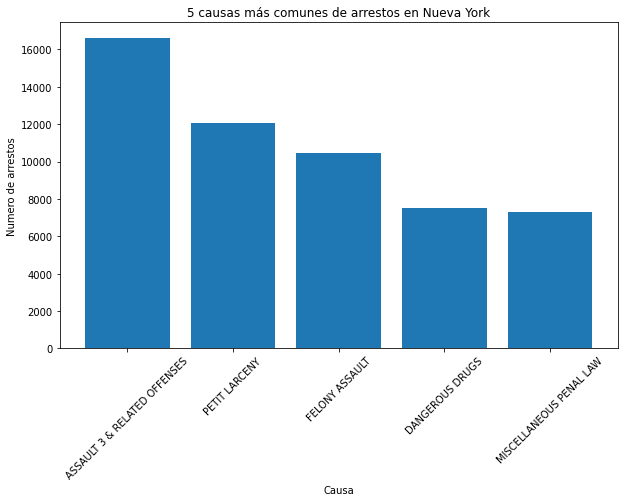

In [0]:
# Crear vista temporal en sql para visualización
arrest_data.createOrReplaceTempView("arrests")

# Consulta SQL para responder la pregunta
consulta_causas_comunes = """
    SELECT OFNS_DESC, COUNT(*) AS ConteoArrestos
    FROM arrests
    GROUP BY OFNS_DESC
    ORDER BY ConteoArrestos DESC
    LIMIT 5
"""

# Ejecutar la consulta SQL
resultado_consulta = spark.sql(consulta_causas_comunes)

# Mostrar resultados de consulta
resultado_consulta.show()

# Extraer los resultados para generar gráfico visual
nombre_causa = [row.OFNS_DESC for row in resultado_consulta.collect()]
conteo_arrestos = [row.ConteoArrestos for row in resultado_consulta.collect()]

# Crear gráfico
plt.figure(figsize=(10, 6))
plt.bar(nombre_causa, conteo_arrestos)
plt.title("5 causas más comunes de arrestos en Nueva York")
plt.xlabel("Causa")
plt.ylabel("Numero de arrestos")
plt.xticks(rotation=45)
plt.show()

### ¿Cómo se ve afectada la tasa de criminalidad según el nivel educativo de la población?



+----+------------------+
|BORO| educacionPromedio|
+----+------------------+
|   1|2.1638916095331373|
|   3|3.0680965775902487|
|   5| 2.518392903730759|
|   4| 2.510192023633678|
|   2| 2.550298193299421|
+----+------------------+

+----+--------------+
|BORO|conteoArrestos|
+----+--------------+
|   1|         25425|
|   3|         30962|
|   5|          4877|
|   4|         23466|
|   2|         26529|
+----+--------------+



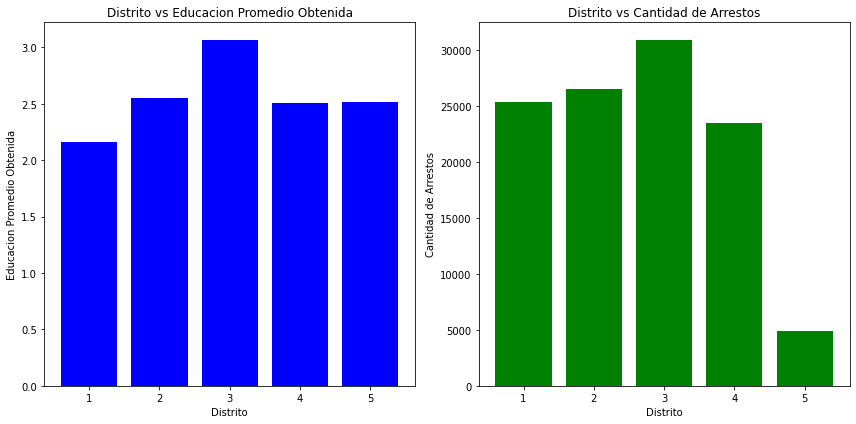

In [0]:
# Crear vistas temporales en sql para visualización
poverty_data.createOrReplaceTempView("poverty_data")
arrest_data.createOrReplaceTempView("arrest_data")

# Crear consulta SQL para calcular el promedio de educacion obtenida para cada distrito
consulta_edu_promedio = """
    SELECT p.BORO, AVG(p.EDUCATTAIN) AS educacionPromedio
    FROM poverty_data p
    GROUP BY p.BORO
"""

# Ejecutar consulta SQl
resultado_edu_promedio = spark.sql(consulta_edu_promedio)

# Mostrar resultado de consulta
resultado_edu_promedio.show()

# Crear consulta SQL para calcular la cantidad de arrestos por distrito
consulta_arrestos_x_distrito = """
    SELECT a.ARREST_BORO AS BORO, COUNT(a.ARREST_KEY) AS conteoArrestos
    FROM arrest_data a
    GROUP BY a.ARREST_BORO
"""

# Ejecutar consulta SQl
resultados_arrestos_x_distrito = spark.sql(consulta_arrestos_x_distrito)

# Mostrar resultado de consulta
resultados_arrestos_x_distrito.show()

# Extraer los resultados para generar dos gráficos visuales
distritos = [row.BORO for row in resultado_edu_promedio.collect()]
promedioEducacion = [row.educacionPromedio for row in resultado_edu_promedio.collect()]
conteo_arrestos = [row.conteoArrestos for row in resultados_arrestos_x_distrito.collect()]

# Crear grafico Distrito vs Educacion Promedio Obtenida
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.bar(distritos, promedioEducacion, color='blue')
plt.title("Distrito vs Educacion Promedio Obtenida")
plt.xlabel("Distrito")
plt.ylabel("Educacion Promedio Obtenida")

# Crear grafico Distrito vs Cantidad de Arrestos
plt.subplot(1, 2, 2)
plt.bar(distritos, conteo_arrestos, color='green')
plt.title("Distrito vs Cantidad de Arrestos")
plt.xlabel("Distrito")
plt.ylabel("Cantidad de Arrestos")

plt.tight_layout()
plt.show()


### ¿Cuáles son los distritos de Nueva York con tasas más altas de pobreza y cómo se relaciona esto con la criminalidad?


+----+------------------+
|BORO|  ingresosPromedio|
+----+------------------+
|   1| 76448.02050719343|
|   3|183995.63486878792|
|   5| 125428.7456240542|
|   4|105020.22255901487|
|   2|109999.46795712644|
+----+------------------+

+----+--------------+
|BORO|conteoArrestos|
+----+--------------+
|   1|         25425|
|   3|         30962|
|   5|          4877|
|   4|         23466|
|   2|         26529|
+----+--------------+



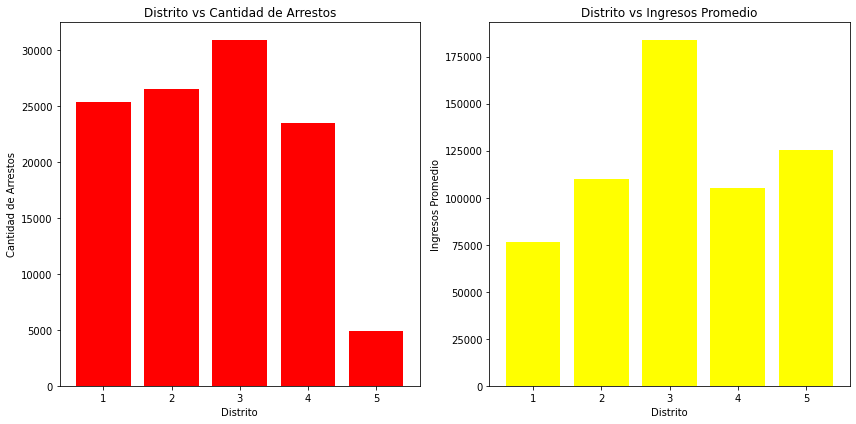

In [0]:
# Crear vistas temporales en sql para visualización
poverty_data.createOrReplaceTempView("poverty_data")
arrest_data.createOrReplaceTempView("arrest_data")

# Crear consulta SQL para calcular el promedio de ingresos por distrito
consulta_ingresos_promedio = """
    SELECT p.BORO, AVG(p.PRETAXINCOME_PU) AS ingresosPromedio
    FROM poverty_data p
    GROUP BY p.BORO
"""

# Ejecutar consulta SQl
resultado_ingresos_promedio = spark.sql(consulta_ingresos_promedio)

# Mostrar resultado de consulta
resultado_ingresos_promedio.show()

# Mostrar resultado de consulta previamente realizada
resultados_arrestos_x_distrito.show()


# Extraer los resultados para generar dos gráficos visuales
distritos = [row.BORO for row in resultados_arrestos_x_distrito.collect()]
conteo_arrestos = [row.conteoArrestos for row in resultados_arrestos_x_distrito.collect()]
ingresos = [row.ingresosPromedio for row in resultado_ingresos_promedio.collect()]

# Crear grafico Distrito vs Cantidad de Arrestos
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.bar(distritos, conteo_arrestos, color='red')
plt.title("Distrito vs Cantidad de Arrestos")
plt.xlabel("Distrito")
plt.ylabel("Cantidad de Arrestos")

# Crear grafico Distrito vs Ingresos Promedio
plt.subplot(1, 2, 2)
plt.bar(distritos, ingresos, color='yellow')
plt.title("Distrito vs Ingresos Promedio")
plt.xlabel("Distrito")
plt.ylabel("Ingresos Promedio")

plt.tight_layout()
plt.show()


### ¿Cómo se relaciona la criminalidad con características demográficas (edad, sexo, raza) de los victimarios? 

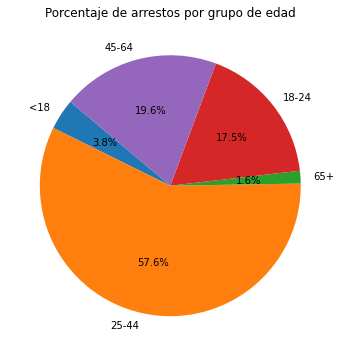

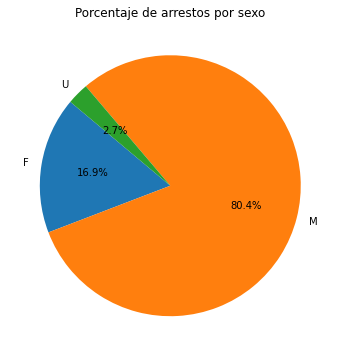

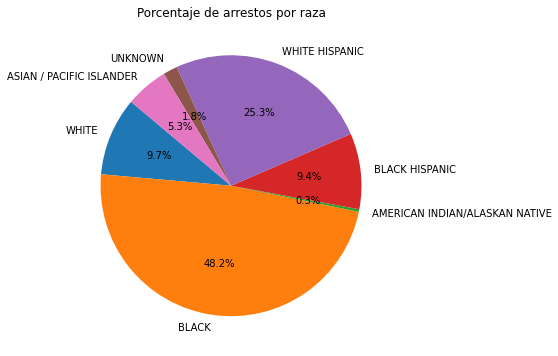

In [0]:
# Crear vistas temporales en sql para visualización
arrest_data.createOrReplaceTempView("arrest_data")

# Crear consultas SQL para calcular el porcentaje de cada población en proporción de los arrestos
consulta_arrestos_x_edad = """
    SELECT AGE_GROUP, COUNT(*) AS ConteoArrestos
    FROM arrest_data
    GROUP BY AGE_GROUP
"""

consulta_arrestos_x_sexo = """
    SELECT PERP_SEX, COUNT(*) AS ConteoArrestos
    FROM arrest_data
    GROUP BY PERP_SEX
"""

consulta_arrestos_x_raza = """
    SELECT PERP_RACE, COUNT(*) AS ConteoArrestos
    FROM arrest_data
    GROUP BY PERP_RACE
"""

# Ejecutar las consultad SQL
resultados_arrestos_x_edad = spark.sql(consulta_arrestos_x_edad)
resultados_arrestos_x_sexo = spark.sql(consulta_arrestos_x_sexo)
resultados_arrestos_x_raza = spark.sql(consulta_arrestos_x_raza)

# Definicion de función para generar los gráficos con la información de cada resultado
def crear_grafico(data, labels, title):
    plt.figure(figsize=(6, 6))
    plt.pie(data, labels=labels, autopct='%1.1f%%', startangle=140)
    plt.title(title)

# Extraer datos para los gráficos y prepararlos para llamar a la función de creacion
labels_edad = [row.AGE_GROUP for row in resultados_arrestos_x_edad.collect()]
data_edad = [row.ConteoArrestos for row in resultados_arrestos_x_edad.collect()]

labels_sexo = [row.PERP_SEX for row in resultados_arrestos_x_sexo.collect()]
data_sexo = [row.ConteoArrestos for row in resultados_arrestos_x_sexo.collect()]

labels_raza = [row.PERP_RACE for row in resultados_arrestos_x_raza.collect()]
data_raza = [row.ConteoArrestos for row in resultados_arrestos_x_raza.collect()]

# Crear y mostrar gráficos
crear_grafico(data_edad, labels_edad, "Porcentaje de arrestos por grupo de edad")
plt.show()

crear_grafico(data_sexo, labels_sexo, "Porcentaje de arrestos por sexo")
plt.show()

crear_grafico(data_raza, labels_raza, "Porcentaje de arrestos por raza")
plt.show()


## Técnicas de Aprendizaje de Máquina
### Preparación de datos

In [0]:
# Quitar datos irrelevantes para el modelo de aprendizaje y datos erroneos en "LAW_CAT_CD"
arrest_data = arrest_data.drop("ARREST_KEY", "ARREST_DATE")
arrest_data = arrest_data.filter((col("LAW_CAT_CD") != "9") & (col("LAW_CAT_CD") != "I"))

# Definir una función para aignar indices numericos a todas las columnas que lo requieran
def convertir_numerico(datos, columnas):
    datos_indexados = datos
    mapeo = {}  # Crear diccionario para los valores originales con su indice asignado
    for column in columnas:
        indexer = StringIndexer(inputCol=column, outputCol=column + "_num")
        indexer_model = indexer.fit(datos_indexados)
        datos_indexados = indexer_model.transform(datos_indexados).drop(column)
        mapeo[column] = {int(i): value for i, value in enumerate(indexer_model.labels)}
    # Imprimir valores unicos con su indice
    for column in columnas:
        columna_indexada = column + "_num"
        unicos = datos_indexados.select(columna_indexada).distinct().orderBy(columna_indexada).collect()
        valores_originales = [mapeo[column][int(row[columna_indexada])] for row in unicos]
        print(f"Valores unicos en {columna_indexada}:")
        for index, value in enumerate(valores_originales):
            print(f"  Indice {index}: {value}")
    return datos_indexados

# Llamar a funcion para convertir datos a numeros
columnas = ["OFNS_DESC","AGE_GROUP", "PERP_SEX", "PERP_RACE", "LAW_CAT_CD"]
arrest_data = convertir_numerico(arrest_data, columnas)

# Mostrar los datos despues de transformación
display(arrest_data)


Valores unicos en OFNS_DESC_num:
  Indice 0: ASSAULT 3 & RELATED OFFENSES
  Indice 1: PETIT LARCENY
  Indice 2: FELONY ASSAULT
  Indice 3: DANGEROUS DRUGS
  Indice 4: MISCELLANEOUS PENAL LAW
  Indice 5: VEHICLE AND TRAFFIC LAWS
  Indice 6: CRIMINAL MISCHIEF & RELATED OF
  Indice 7: ROBBERY
  Indice 8: GRAND LARCENY
  Indice 9: DANGEROUS WEAPONS
  Indice 10: OFFENSES AGAINST PUBLIC ADMINI
  Indice 11: BURGLARY
  Indice 12: OTHER OFFENSES RELATED TO THEF
  Indice 13: OFFENSES INVOLVING FRAUD
  Indice 14: SEX CRIMES
  Indice 15: OFF. AGNST PUB ORD SENSBLTY &
  Indice 16: POSSESSION OF STOLEN PROPERTY
  Indice 17: FORGERY
  Indice 18: INTOXICATED & IMPAIRED DRIVING
  Indice 19: OTHER TRAFFIC INFRACTION
  Indice 20: CRIMINAL TRESPASS
  Indice 21: MURDER & NON-NEGL. MANSLAUGHTE
  Indice 22: GRAND LARCENY OF MOTOR VEHICLE
  Indice 23: OFFENSES AGAINST THE PERSON
  Indice 24: NYS LAWS-UNCLASSIFIED FELONY
  Indice 25: OTHER STATE LAWS
  Indice 26: RAPE
  Indice 27: FRAUDS
  Indice 28: BURGLAR'S

ARREST_BORO,Latitude,Longitude,OFNS_DESC_num,AGE_GROUP_num,PERP_SEX_num,PERP_RACE_num,LAW_CAT_CD_num
1,40.733876,-74.005428,1.0,0.0,0.0,0.0,0.0
5,40.644996,-74.077263,2.0,0.0,0.0,2.0,1.0
3,40.602464,-74.00346,2.0,1.0,0.0,2.0,1.0
5,40.642316,-74.091908,0.0,3.0,1.0,0.0,0.0
3,40.702901,-73.921203,32.0,0.0,1.0,2.0,1.0
1,40.739153,-74.001104,0.0,1.0,0.0,2.0,0.0
5,40.6447209438691,-74.0770327198983,26.0,0.0,0.0,0.0,1.0
5,40.6447209438691,-74.0770327198983,26.0,1.0,0.0,0.0,1.0
4,40.7434812638841,-73.8740035373971,26.0,0.0,0.0,1.0,1.0
3,40.6954388081238,-73.9832253756043,26.0,0.0,0.0,3.0,1.0


In [0]:
# Columnas a incluir en la matriz de correlacion
Columnas_Correlacion = ["ARREST_BORO", "Latitude", "Longitude", "AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

# Crear ensamblador de vectores
assembler = VectorAssembler(inputCols=Columnas_Correlacion, outputCol="features")
assembled_data = assembler.transform(arrest_data)

# Calcular la matriz de correlacion
corr_matrix = Correlation.corr(assembled_data, "features").head()

# Convertir la matriz de correlacion a pandas
corr_df = pd.DataFrame(corr_matrix[0].toArray())

# Mostrar el resultado: Es posible observar que no es necesario remover variables puesto que no se evidencia ninguna correlacion marcada entre las variables independientes
display(corr_df)

0,1,2,3,4,5,6
1.0,-0.32473233042550304,0.05725009577743086,0.0029855768328878414,-7.389126083548543E-5,0.047459733744296705,0.02103857551432825
-0.32473233042550304,1.0,-0.7334313063625304,0.005242195850814624,0.00940002963326912,0.0027888136716168245,-0.019025285884746276
0.05725009577743086,-0.7334313063625304,1.0,-7.118095214112509E-4,1.5517338616438355E-4,0.0055733101323674145,-4.026546882636507E-4
0.0029855768328878414,0.005242195850814624,-7.118095214112509E-4,1.0,0.0027555975435048837,-0.0048912341355609006,0.06295848518477204
-7.389126083548543E-5,0.00940002963326912,1.5517338616438355E-4,0.0027555975435048837,1.0,0.03439529739195504,-0.05118479122806797
0.047459733744296705,0.0027888136716168245,0.0055733101323674145,-0.0048912341355609006,0.03439529739195504,1.0,-0.037119464032828564
0.02103857551432825,-0.019025285884746276,-4.026546882636507E-4,0.06295848518477204,-0.05118479122806797,-0.037119464032828564,1.0


### Support Vector Machines
#### Aprendizaje Supervisado

In [0]:
# Convertir datos a formato pandas para utilizar libreria SkLearn
arrest_data = arrest_data.toPandas()


# Definir variable objetivo y variables independientes
target_column = "OFNS_DESC_num"
independent_columns = ["ARREST_BORO", "Latitude", "Longitude", "AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.2853903466148364


In [0]:
# Definir variable objetivo y variables independientes
target_column = "PERP_SEX_num"
independent_columns = ["OFNS_DESC_num", "ARREST_BORO", "Latitude", "Longitude", "AGE_GROUP_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.8049526688982471


In [0]:
# Definir variable objetivo y variables independientes
target_column = "PERP_RACE_num"
independent_columns = ["OFNS_DESC_num",  "Latitude", "Longitude", "AGE_GROUP_num",  "PERP_SEX_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.5060648598063564


In [0]:
# Definir variable objetivo y variables independientes
target_column = "PERP_RACE_num"
independent_columns = ["OFNS_DESC_num",  "AGE_GROUP_num",  "PERP_SEX_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.48266925817946227


In [0]:
# Definir variable objetivo y variables independientes
target_column = "LAW_CAT_CD_num"
independent_columns = [  "AGE_GROUP_num",  "PERP_SEX_num", "PERP_RACE_num",  "Latitude", "Longitude"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.577259475218659


In [0]:
# Definir variable objetivo y variables independientes
target_column = "PERP_SEX_num"
independent_columns = ["Latitude", "Longitude", "AGE_GROUP_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo con un kernel RBF
classifier = SVC(kernel='rbf', random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.8049526688982471


### K-Means Clustering
#### Aprendizaje No Supervisado

In [0]:
# Definir variables a utilizar en el modelo
feature_columns = ["ARREST_BORO", "Latitude", "Longitude", "AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]
X = arrest_data[feature_columns]

# Especificar el numero de clusters a formar
k = 3

# Estandarizar las variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Crear instancia del modelo
kmeans = KMeans(n_clusters=k, random_state=1)
kmeans.fit(X_scaled)

# Crear predicciones en los datos
predictions = kmeans.predict(X_scaled)

# Evaluar el modelo
silhouette = silhouette_score(X_scaled, predictions)
print("Puntaje de prueba de silueta:", silhouette)

# Calcular "within-cluster sum of squares" (WCSS)
wcss = kmeans.inertia_
print("Within-Cluster Sum of Squares (WCSS):", wcss)

Puntaje de prueba de silueta: 0.19182347799871166
Within-Cluster Sum of Squares (WCSS): 495739.75565140415


In [0]:
# Definir variables a utilizar en el modelo
feature_columns = ["ARREST_BORO", "AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]
X = arrest_data[feature_columns]

# Especificar el numero de clusters a formar
k = 3

# Estandarizar las variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Crear instancia del modelo
kmeans = KMeans(n_clusters=k, random_state=1)
kmeans.fit(X_scaled)

# Crear predicciones en los datos
predictions = kmeans.predict(X_scaled)

# Evaluar el modelo
silhouette = silhouette_score(X_scaled, predictions)
print("Puntaje de prueba de silueta:", silhouette)

# Calcular "within-cluster sum of squares" (WCSS)
wcss = kmeans.inertia_
print("Within-Cluster Sum of Squares (WCSS):", wcss)

Puntaje de prueba de silueta: 0.23743167977744217
Within-Cluster Sum of Squares (WCSS): 384573.30106659385


In [0]:
# Definir variables a utilizar en el modelo
feature_columns = ["AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]
X = arrest_data[feature_columns]

# Especificar el numero de clusters a formar
k = 2

# Estandarizar las variables
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Crear instancia del modelo
kmeans = KMeans(n_clusters=k, random_state=1)
kmeans.fit(X_scaled)

# Crear predicciones en los datos
predictions = kmeans.predict(X_scaled)

# Evaluar el modelo
silhouette = silhouette_score(X_scaled, predictions)
print("Puntaje de prueba de silueta:", silhouette)

# Calcular "within-cluster sum of squares" (WCSS)
wcss = kmeans.inertia_
print("Within-Cluster Sum of Squares (WCSS):", wcss)

Puntaje de prueba de silueta: 0.3141548412927806
Within-Cluster Sum of Squares (WCSS): 334864.176275781


### Neural Network
#### Apredizaje Profundo

In [0]:
# Import necessary libraries
from sklearn.neural_network import MLPClassifier

# Definir variable objetivo y variables independientes
target_column = "OFNS_DESC_num"
independent_columns = ["ARREST_BORO", "Latitude", "Longitude", "AGE_GROUP_num", "PERP_SEX_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo de red neuronal
# You can adjust the parameters of MLPClassifier as needed
# For example, you can change hidden_layer_sizes, activation, solver, etc.
classifier = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)


Precision: 0.30108339632149156


In [0]:
# Definir variable objetivo y variables independientes
target_column = "PERP_SEX_num"
independent_columns = ["Latitude", "Longitude", "AGE_GROUP_num", "PERP_RACE_num", "LAW_CAT_CD_num"]

X = arrest_data[independent_columns]
y = arrest_data[target_column]

# Dividir datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=0)

# Estandarizar las variables
sc = StandardScaler()
X_train = sc.fit_transform(X_train)
X_test = sc.transform(X_test)

# Entrenar el modelo de red neuronal
# You can adjust the parameters of MLPClassifier as needed
# For example, you can change hidden_layer_sizes, activation, solver, etc.
classifier = MLPClassifier(hidden_layer_sizes=(100,), max_iter=1000, random_state=0)
classifier.fit(X_train, y_train)

# Realizar predicciones con el conjunto de prueba
y_pred = classifier.predict(X_test)

# Evaluar precision del modelo
accuracy = accuracy_score(y_test, y_pred)
print("Precision:", accuracy)

Precision: 0.8049166756649749
